# NOP Genes Splice Variants in Maize

**Goal**: To confirm/identify splice variants in the NOP Genes by using RNAseq data

## Background

nop1 and nop2 genes are related to pollen in maize (the B73v5 genome)

nop1 - Zm00001eb386570 - chr9:96744687..96751876 - chr9:96744687-96751876

nop2 - Zm00001eb235890 - chr5:119270170..119270996 - chr5:119270170-119270996

We are trying to confirm splice variants for nop1 and nop2. Nop1 has a fairly well documented gene model, but the nop2 gene model seems to be incomplete.

Some of the Fowler Lab research has already touched on this, and providing more evidence about the splice variants can upport ongoing research.

### Resources
> Warman paper about transposable elements in pollen - the source of the RNAseq data - https://journals.plos.org/plosgenetics/article?id=10.1371/journal.pgen.1008462


## Step 1 - *Acquiring RNAseq data*

To retrieve the RNAseq data that we need to run our analysis, I found the IRODS file path at this link (https://qteller.maizegdb.org/rna_data_sources.php). Because I was using a Mac computer, getting IRODS to work was a bit tricky, but there was a program that installed it for me, unfortunately I can't find the link anymore.

Command to download using IRODS

`iget -P -K -r -b -T -X checkpointfile.txt /iplant/home/maizegdb/maizegdb/B73v5_JBROWSE_AND_ANALYSES/B73v5_RNA-seq`

*This process can take hours/days and a lot of space. In hindsight, I only needed some of the files (in the Warman pollen RNASeq files). Also had to use an external drive.*

## Step 2 - *Using StringTie to process the BAM files into GTF*

### Resources
> download stringtie - https://ccb.jhu.edu/software/stringtie/#install
> download B73v5 reference genome - https://www.maizegdb.org/assembly

I processed files without a reference file, and I used this instruction manual (https://ccb.jhu.edu/software/stringtie/index.shtml?t=manual).

I actually wrote a script to process all the files for me. Also, it's important to note I'm pasting the code with my file structure on it. That's not necessarily how your computer will have it.I actually wrote a script to process all the files for me. Also, it's important to note I'm pasting the code with my file structure on it. That's not necessarily how your computer will have it.

In [ ]:
import os

bamdirectory = 'BAM_B73v5_Warman_Pollen_RNAseq/'
gtfdirectory = 'GTF_Files_B73v5_Warman_Pollen_RNAseq/'

for filename in os.scandir(bamdirectory):
	if filename.is_file():
		identifier = filename.path
		identifierbase = identifier[31:41]
		ext = '.gtf'
		bamfilename = ' ~/Desktop/ResearchZm/NOP_Genes/BAM_B73v5_Warman_Pollen_RNAseq/' + identifier[31:]
		newfilename = identifierbase + 'wrefA' + ext
		command = '/Users/tell/Desktop/Code/programs/stringtie-2.2.0.OSX_x86_64/./stringtie -o ~/Desktop/ResearchZm/NOP_Genes/GTF_Files_B73v5_Warman_Pollen_RNAseq/' + newfilename + bamfilename
		os.system(command)

The output of this was a set of gtf files for each of the RNAseq bam files, which were taken from different tissues. I also merged these files.

| study_accession | sample_accession | run_accession | scientific_name | sample_title |
| --- | --- | --- | --- | --- |
| PRJNA394743 | SAMN07358426 | SRR5832602 | Zea mays | Mature Pollen 2 |
| PRJNA394743 | SAMN07358425 | SRR5832603 | Zea mays | Mature Pollen 1 |
| PRJNA394743 | SAMN07358428 | SRR5832604 | Zea mays | Mature Pollen 4 |
| PRJNA394743 | SAMN07358427 | SRR5832605 | Zea mays | Mature Pollen 3 |
| PRJNA394743 | SAMN07358430 | SRR5832606 | Zea mays | Sperm Cell 2 |
| PRJNA394743 | SAMN07358429 | SRR5832607 | Zea mays | Sperm Cell 1 |
| PRJNA394743 | SAMN07358432 | SRR5832608 | Zea mays | Sperm Cell 4 |
| PRJNA394743 | SAMN07358431 | SRR5832609 | Zea mays | Sperm Cell 3 |
| PRJNA394743 | SAMN07358434 | SRR5832610 | Zea mays | Microspore 2 |
| PRJNA394743 | SAMN07358433 | SRR5832611 | Zea mays | Microspore 1 |
| PRJNA394743 | SAMN07358438 | SRR5832617 | Zea mays | Tassel Primordia 2 |
| PRJNA394743 | SAMN07358437 | SRR5832618 | Zea mays | Tassel Primordia 1 |
| PRJNA394743 | SAMN07358436 | SRR5832619 | Zea mays | Microspore 4 |
| PRJNA394743 | SAMN07358435 | SRR5832620 | Zea mays | Microspore 3 |
| PRJNA394743 | SAMN07358441 | SRR5832622 | Zea mays | Bicellular Male Gametophyte |
| PRJNA394743 | SAMN07358440 | SRR5832623 | Zea mays | Tassel Primordia 4 |
| PRJNA394743 | SAMN07358439 | SRR5832624 | Zea mays | Tassel Primordia 3 |

The run accession id is how the files are named.

The code entered into my terminal to create the merged file was:

`/Users/tell/Desktop/Code/programs/stringtie-2.2.0.OSX_x86_64/./stringtie --merge -p 4 -o stringtie_merged.gtf -G Zea_mays.Zm-B73-REFERENCE-NAM-5.0.52.gff3 assembly_GTF_list.txt`

The individual files have TPM, cov, and FPKM values that don't carry over into the merged value (at least not visibly).

## Step 3 - *Combine individual Mature Pollen GTF files where nop1 and nop2 to retain cov, TPM, and FPKM value*

I needed to write a program to combine the GTFs from the four Mature Pollen GTFs, without using merge, because I still needed the cov, TPM, and FPKM values to determine which of the sections had more read coverage. I wrote the following Python script, and input the filtering values, so that I would only get relevant records.

In [ ]:
import csv
import re

def load_csv(file):
	with open(file, 'r', encoding='utf-8-sig') as loadedfile:
		reader = csv.reader(loadedfile)
		filelist = []
		#for row in csv.DictReader(loadedfile, skipinitialspace=True):
		#	print(row)
		filelist = [{key: value.strip("'") for key, value in row.items()}
			for row in csv.DictReader(loadedfile, skipinitialspace=True)]
	return filelist

def load_into_list(list):
	fullgtf = []
	for item in range(2, len(list)):
		for key, value in list[item].items():
			linelist = value.split("\t")
			line = {
				'seqname': linelist[0],
				'source': linelist[1],
				'feature': linelist[2],
				'start': int(linelist[3]),
				'end': int(linelist[4]),
				'score': int(linelist[5]),
				'strand': linelist[6],
				'frame': linelist[7],
				'attribute': linelist[8].strip('"')
			}
			fullgtf.append(line)
	return fullgtf

def sort_list(list):
	sortedlist = []
	for item in range(len(list)):
		if list[item]['seqname'] == 'chr5' and list[item]['start'] > 119235000 and list[item]['end'] < 119375000:
			sortedlist.append(list[item])
		elif list[item]['seqname'] == 'chr9' and list[item]['start'] > 96730000 and list[item]['end'] < 96760000:
			sortedlist.append(list[item])
		else:
			pass
	return sortedlist

def main():
	wref602 = sort_list(load_into_list(load_csv('SRR5832602wref.gtf')))
	finallist = wref602
	wref603 = sort_list(load_into_list(load_csv('SRR5832603wref.gtf')))
	finallist = finallist + wref603
	wref604 = sort_list(load_into_list(load_csv('SRR5832604wref.gtf')))
	finallist = finallist + wref604
	wref605 = sort_list(load_into_list(load_csv('SRR5832605wref.gtf')))
	finallist = finallist + wref605
	print(finallist)
	keys = finallist[0].keys()
	with open('MPfiltered.gtf', 'w', newline='')  as output_file:
		dict_writer = csv.DictWriter(output_file, keys, delimiter='\t', quoting=csv.QUOTE_NONE, quotechar='',escapechar='\\')
		dict_writer.writerows(finallist)

main()

`if list[item]['seqname'] == 'chr5' and list[item]['start'] > 119235000 and list[item]['end'] < 119375000:`
This code gets me lines that are on chr5 and between nucleotides 119,235,000 and 119,375,000. This is for nop2 and some surrounding gene models.

`elif list[item]['seqname'] == 'chr9' and list[item]['start'] > 96730000 and list[item]['end'] < 96760000:`
This code gets me lines that are on chr9 and between nucleotides 9,6730,000 and 9,6760,000. This is for nop2 and some surrounding gene models.

## Step 4 - *Convert GTF to GFF3 and Visualize on JBrowse*

In order to visualize the filtered information from step 3, we need to convert the filtered GTF to a GFF3 and then load into JBrowse.

I converted a correctly formatted GTF into a GFF3 by using the following command in the terminal:

`/Users/tell/Desktop/Code/programs/gffread-0.12.7/./gffread -E MPfilterednoref.gtf -o MPfilterednoref.gff3`

Once I had this, I loaded it into JBrowse. When uploading, I navigated to Track > Open track file or URL. I uploaded my file and kept all of the defaults, except I changed the display option from "CanvasFeatures" to "HTMLFeatures."

## Step 5 - *Analyze and Determine Mostly Likely Variant*

#### nop1 - Testing out methodology
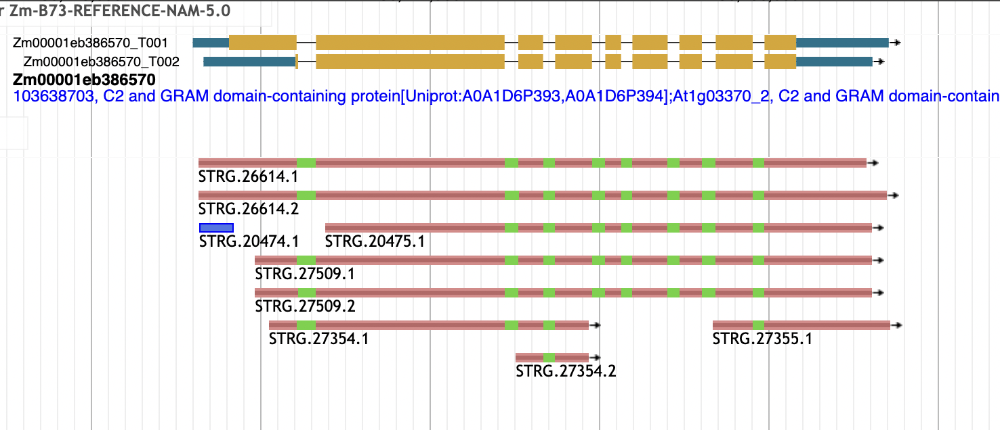

Using JBrowse, I chose the most likely transcripts, based on which ones overlapped where NOP1 is. Next I chose the transcripts with the highest coverage, FPKM, and TPM.

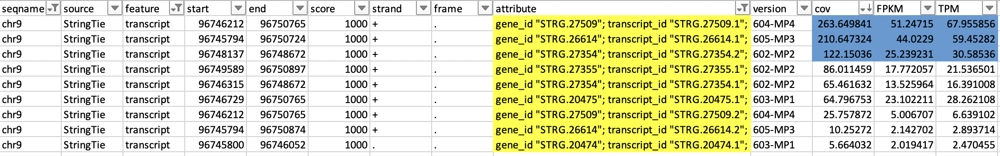

As you can see in the screenshot, the start and end of the two chosen transcripts, STRG.27509.1 (from Mature Pollen 4 sample) and STRG.26614.1 (from Mature Pollen 3 sample), were relatively similar, which bodes well. 

| start | end | transcript name | version | cov | FPKM | TPM |
| --- | --- | --- | --- | --- | --- | --- |
| 96746212 | 96750765 | STRG.27509.1 | 604-MP4 | 263.649841 | 51.24715 | 67.955856 |
| 96745794 | 96750724 | STRG.26614.1 | 605-MP3 | 210.647324 | 44.0229 | 59.45282 |

Next, we check if it matches the existing gene model in JBrowse: 

> Zm00001e037435_T001
> chr9:96745753..96750888
> Zm00001eb386570_T002
> chr9:96745832..96750768

It matches relatively well. The start of STRG.26614.1 and end of STRG.27509.1 are closest. So then, I needed to do exon analysis.

##### Exon 1
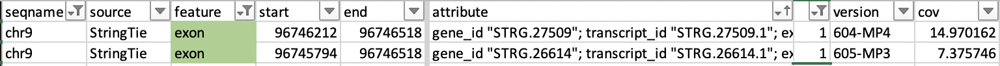
The start of the first exon isn't the same, but the ending is. This is encouraging.

##### Exon 2
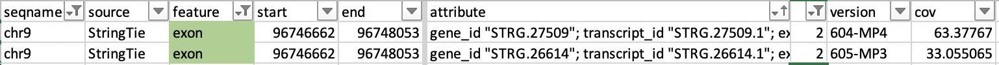
Matching!

##### Exon 3
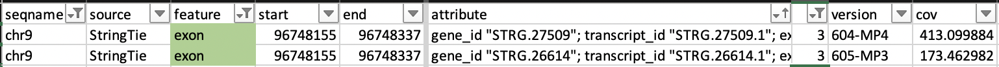
Matching!

##### Exon 4
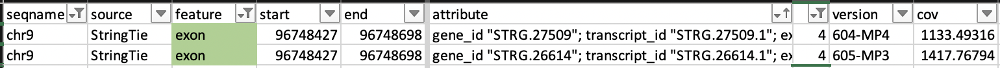
Matching!

##### Exon 5
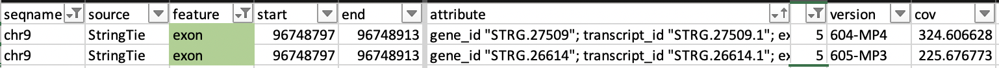
Matching!

##### Exon 6
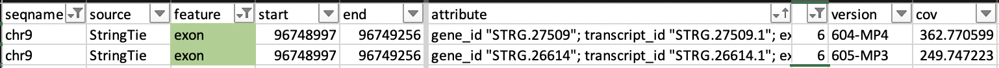
Matching!

##### Exon 7
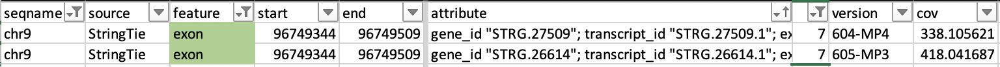
Matching!

##### Exon 8
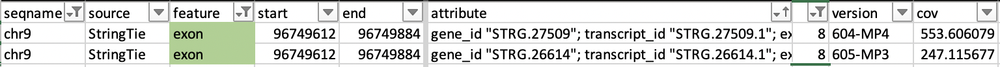
Matching!

##### Exon 9
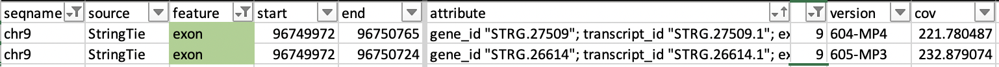
The start of this exon matches, but the end doesn't.

| exon | start | end | 
| --- | --- | --- | 
| 1 | 96745794 | 96746518 |
| 2 | 96746662 | 96748053 | 
| 3 | 96748155 | 96748337 | 
| 4 | 96748427 | 96748698 | 
| 5 | 96748797 | 96748913 | 
| 6 | 96748997 | 96749256 | 
| 7 | 96749344 | 96749509 | 
| 8 | 96749612 | 96749884 | 
| 9 | 96749972 | 96750765 | 

I compared these identified exons to the official gene model in JBrowse. All the exons matches, except the start of exon1 and the stop of exon 9. In the official gene model, the gene starts at 96745753, while the mRNA starts at 96746020. The end of the mRNA is 96750205 and the end of the gene is 96750888.


#### nop2 - Detailed analysis
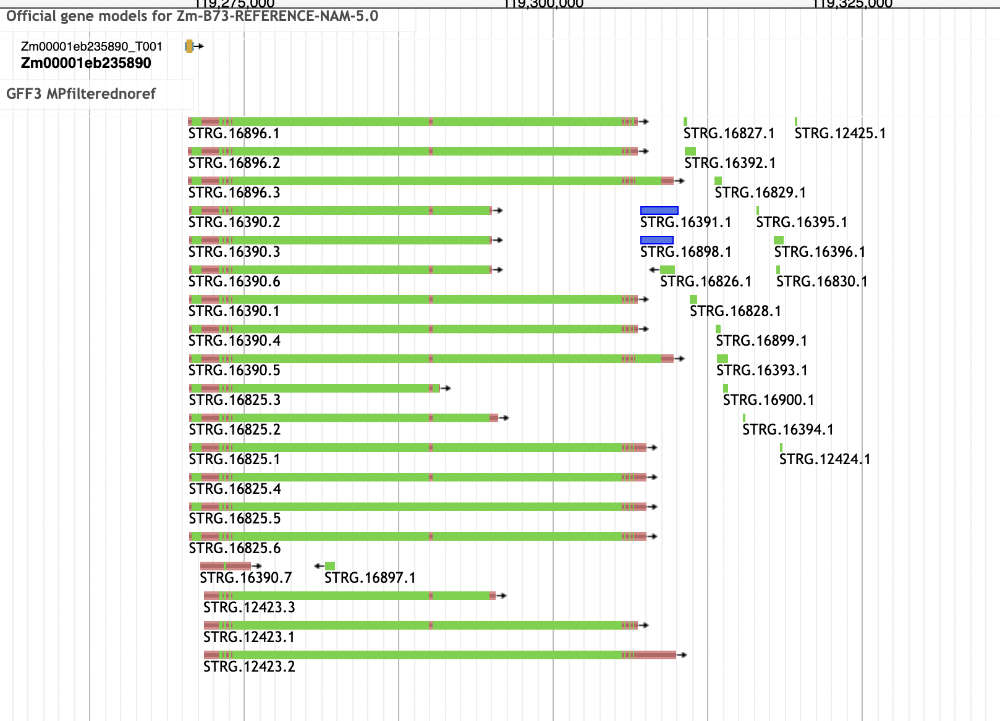
Using JBrowse, I chose the most likely transcripts, based on which ones overlapped where NOP2 is. Next I chose the transcripts with the highest coverage, FPKM, and TPM.

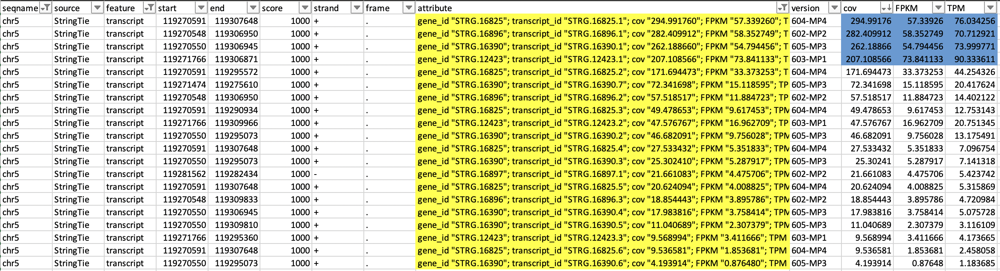

Our top potentials are: STRG.12423.1 (MP1), STRG.16390.1 (MP3), STRG.16825.1 (MP4),and STRG.16896.1 (MP2). In conversation, Dr. Fowler told me there was something wonky with the MP1 test, so those results might not be what we're looking for. Interestingly, STRG.12423.1 (MP1) only has 9 exons, while the other 3 have 10 exons.

##### Exon 1
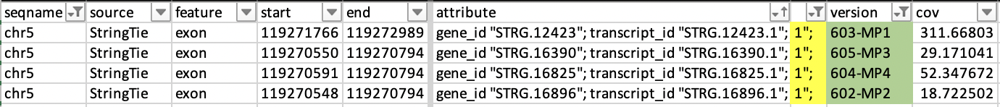
The start for MP2, MP3, and MP4 are a bit staggered, but the end matches perfectly. I think it would safer to have a wider exon for analysis, especially for the first exon, so that's what I'll choose.

##### Exon 2
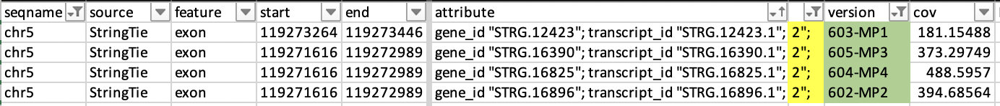
Again, MP2, MP3, and MP4 match perfectly, this is giving good evidence.

##### Exon 3
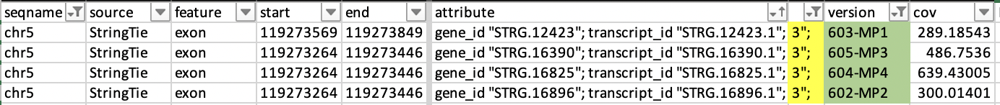
Matching again.

##### Exon 4
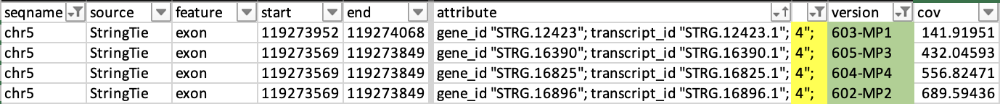
Matching again.

##### Exon 5
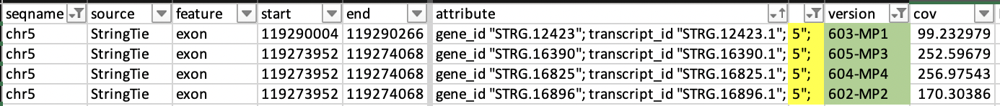
Matching again.

##### Exon 6
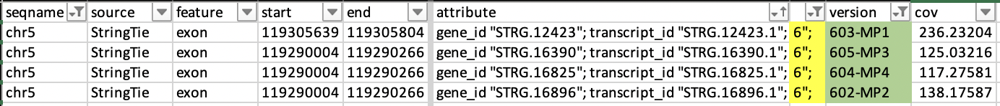
Matching again.

##### Exon 7
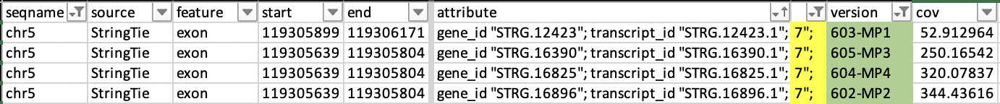
Matching again.

##### Exon 8
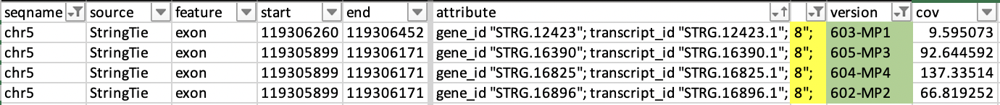
Matching again.

##### Exon 9
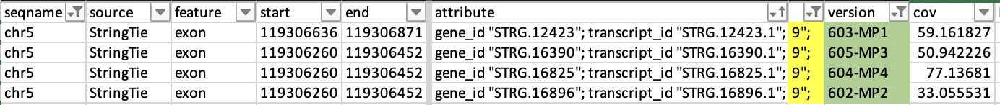
Matching again.

##### Exon 10
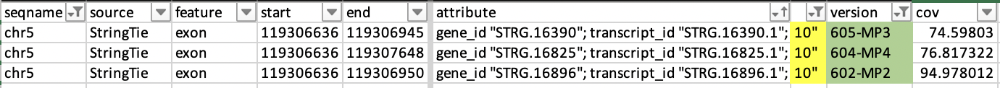
Again, MP2, MP3, and MP4 match at the start but not the end, so I'm going to the most inclusive one.

| exon | start | end | 
| --- | --- | --- | 
| 1 | 119270548 | 119270794 | 
| 2 | 119271616 | 119272989 | 
| 3 | 119273264 | 119273446 | 
| 4 | 119273569 | 119273849 | 
| 5 | 119273952 | 119274068 | 
| 6 | 119290004 | 119290266 | 
| 7 | 119305639 | 119305804 | 
| 8 | 119305899 | 119306171 | 
| 9 | 119306260 | 119306452 | 
| 10 | 119306636 | 119307648 | 

## Step 6 - *Protein Analysis*

The next part of the analysis is to determine the most likely protein sequence. I ran these python scripts to put together the CDS, find the ATG sequence and translate from there.


#### nop1

In [ ]:
from Bio.Seq import Seq
from Bio import SeqIO
from Bio import SeqUtils
import csv

sequences = SeqIO.parse('B73v5_Official/Zm-B73-REFERENCE-NAM-5.0.fa','fasta')
entirefasta = list(sequences)
fastadict = {}
for item in entirefasta:
	fastadict[item.id] = item.seq


exon1 = fastadict['chr9'][96745793:96746518]
exon2 = fastadict['chr9'][96746661:96748053]
exon3 = fastadict['chr9'][96748154:96748337]
exon4 = fastadict['chr9'][96748426:96748698]
exon5 = fastadict['chr9'][96748796:96748913]
exon6 = fastadict['chr9'][96748996:96749256]
exon7 = fastadict['chr9'][96749343:96749509]
exon8 = fastadict['chr9'][96749611:96749884]
exon9 = fastadict['chr9'][96749971:96750765]

cds = exon1 + exon2 + exon3 + exon4 + exon5 + exon6 + exon7 + exon8 + exon9


start = Seq('ATG')

startposition = 96745794
cds1 = cds
start = Seq('ATG')

proteinoptions = []
while len(cds1) > 10:
	startfind = cds1.find(str(start))
	if startfind == -1:
		break
	potential = cds1[startfind:].translate(to_stop=True)
	cds1 = cds1[startfind+1:]
	individualoption = {
		'startpos': startposition+1+startfind,
		'sequence': potential
	}
	proteinoptions.append(individualoption)
	startposition = startposition+1+startfind+1
	print(len(cds1))


keys = proteinoptions[0].keys()
with open('proteinoptionsnop1.csv', 'w', newline='')  as output_file:
	dict_writer = csv.DictWriter(output_file, keys)
	dict_writer.writeheader()
	dict_writer.writerows(proteinoptions)

When examining the potential protein options, the longest sequence is also the most likely and it starts at 96746026:

> MTKSAARSASTVSEAAAAAAAMSLPSMTKPGRNSTTSVEAATESALRVTPMKLLVRVVEARGLPAVHLNGSSDPFVKLKLGKRRAKTAVVKRSLSPAWDEEFSFLVGNVAEELVVSVLNEDKYFSNDLLGQVRLPLSQVMETDDLSLGTQWYQLQPKSKKSKKKCRGEVCLHVSLSTRTHVSEESQSVPHPASDDLASSSDSTIEHKTLSTTYSCIDLSAVPSIERASRSSFERFPSSILEQPDRSSVEDLAAPDPGGPAAAADTDAMPTPSSVVEVLSRYFFRKPENATVQQVQHSVASDTTDHPVVDRQLQEPNASSSEDREIPERVTVPEPSLDELLKVMESKDQGSEMPAALPGGTLVDESYVAAPTELNSLLFSASSDFWPAVAELQGTSGFQIEPWKLDSSESFVQRTLSYTKAASKLVKAVKATEEQKYLKAAGNSYAVFSVVSTPDVPCGNCFKVEILYCVTPGPQLPSEEQTCHLTVSWRVNFVQSTMIKGMIESGAKQGMAEGFAQFSEVLSQKLKTAELDDANSNKEKILASLHAQKESCWRLVVRFLGNFTFIFSVAIALYVIAHLHLSKPDVMHGLEYFGLDLPDSIGEVVVCAVLILQGQNIVKVTRRFLSAWKQRGSDHGVKAHGDGWLLTVALIEGTGIIATGSSDLFDIYVVFTCNAKRKTSSIKFQTSDPKWNEIFEFDAMDDPPSRMDVAIYDSSGQCVIGHTEVNFLKNNLSELTDIWLPVSGKCDQASNPRLHLRIFLNNSRGTEVVMNYLAKMGKEVGKKINLRSAQTNVAFRKLFALPLEEFLIDDFTCHLKRKMPLQGRLFFSPRIVGFYSNIFGHKTKFFFLWEDVDDIQVIPATLSIGSPSLMIILRKDRGLEAKHGAKGTDHHGRLKFVFQSFVSFNDAYRIITAIWKIRALSPEQKGEATEKDEVKELLPEEAGTLFTNADVKMSEIFSSVLSVDVESLMEMFSGGPLEHKMMQKAGCIDYTATQWELVGCNIQQRQTSYKLDKNLSRHGGEAATTEQKYSLVNQDGWAIEKVMTLQGVLLADHFNLQMKYCITNVPSKPNTCSVLVLLGIAWLKSTKQQKKVTKSIISNTSNGLKELFAEVEKELTSSSSSHPNVAAGPTTA

#### nop2

In [ ]:
from Bio.Seq import Seq
from Bio import SeqIO
from Bio import SeqUtils
import csv

sequences = SeqIO.parse('B73v5_Official/Zm-B73-REFERENCE-NAM-5.0.fa','fasta')
entirefasta = list(sequences)
fastadict = {}
for item in entirefasta:
	fastadict[item.id] = item.seq


exon1 = fastadict['chr5'][119270547:119270794]
exon2 = fastadict['chr5'][119271615:119272989]
exon3 = fastadict['chr5'][119273263:119273446]
exon4 = fastadict['chr5'][119273568:119273849]
exon5 = fastadict['chr5'][119273951:119274068]
exon6 = fastadict['chr5'][119290003:119290266]
exon7 = fastadict['chr5'][119305638:119305804]
exon8 = fastadict['chr5'][119305898:119306171]
exon9 = fastadict['chr5'][119306259:119306452]
exon10 = fastadict['chr5'][119306635:119307648]

cds = exon1 + exon2 + exon3 + exon4 + exon5 + exon6 + exon7 + exon8 + exon9 + exon10


start = Seq('ATG')

startposition = 119270548
cds1 = cds
start = Seq('ATG')

proteinoptions = []
while len(cds1) > 10:
	startfind = cds1.find(str(start))
	if startfind == -1:
		break
	potential = cds1[startfind:].translate(to_stop=True)
	cds1 = cds1[startfind+1:]
	individualoption = {
		'startpos': startposition+1+startfind,
		'sequence': potential
	}
	proteinoptions.append(individualoption)
	startposition = startposition+1+startfind+1
	print(len(cds1))


keys = proteinoptions[0].keys()
with open('proteinoptions.csv', 'w', newline='')  as output_file:
	dict_writer = csv.DictWriter(output_file, keys)
	dict_writer.writeheader()
	dict_writer.writerows(proteinoptions)

The protein sequence that's the most likely (longest) starts at 119270711:

>METDDLSLGTRWYQLQPRSGVKFRKKRRGEICLRVYLSVRATLCDDAHQAPPQLIDDISCSSHRSIETNESPLSATVNSLDMSACASMDRTSLKSSDGFNQSMTEVRGPRSTGPLSCVSIEQSILLEPEEDDGSAIVDTSSVVEVMSRYFRKTADATHSVASDPVSLDQFRSTQMNSECRENEEGCTLPEVSLDELLKNMESKDQACELPGNLPGGVLMDQSYIIAPAELNSLLFSGTSDFWPEVSELQGTSGFNIEPWKHDNNENCLKRTITYTKAASKLVKSVKATEEQKYLKATGSSFAVLSSVSTPDVPCGNCFKVEILYRIISGSQLPLEQTTQITVSWRLNFVQSTMLKGMIENGAKQGLAEGYSHFSEVLSRKVKVAELADANTKDKILASLQTQKESNWKLVARFLGSFAFICSLSTALYITTHLHLAKPNVVLGGLEYFGIDLPDSIGEIVFCIILIIQGHNIMKVGRRFLQAWKQRGSDHGVKAHGDGWLLTIALIEGSGVVSAGTPGVPDPYVVFTCNGKRKTSSVKYQTSEPKWNEIFEFDAMDDPPARLDVVVHDSDIPNNETPIGQTEVNFVKNNLSDLGDMWVPLDGRFPQGHQPKLHLRIFLNNSRGTEVVMNYLEKMGKEVGKKMHLRSSQTNSAFRKLFSLPPEEFLIDDFTCHLKRKMPLQGRLFLSPRITGFYSNIFGRKTKFFFLWEDIENIQVVPPKLATVGSPSLMIILCKDRGLEARHGAKALDPQGRLKFHFQTFVSFNDAHRIIMAIWKLRSSGLEQKGEVIDKEPELKENPYEEGSLLANEDVKMSEVYSAVLSVDVSALMEMFSGGPLEHKVMERAGCVDYLATEWELLNRNVYQRHINFRFDKSLSRYGGEATTTQQKYNLPNQNDWIVEEVMTLQGVQHEDYSSIQLKYHMTSTPLRPNSCRIKVLLGIAWLKGTKHQKKAAKNVMMNSANRLREIFSEVEKEVTSRKVPASG

## Step 7 - *Protein BLAST*

We ran a BLASTp on the two protein sequences from nop1 and nop2. 
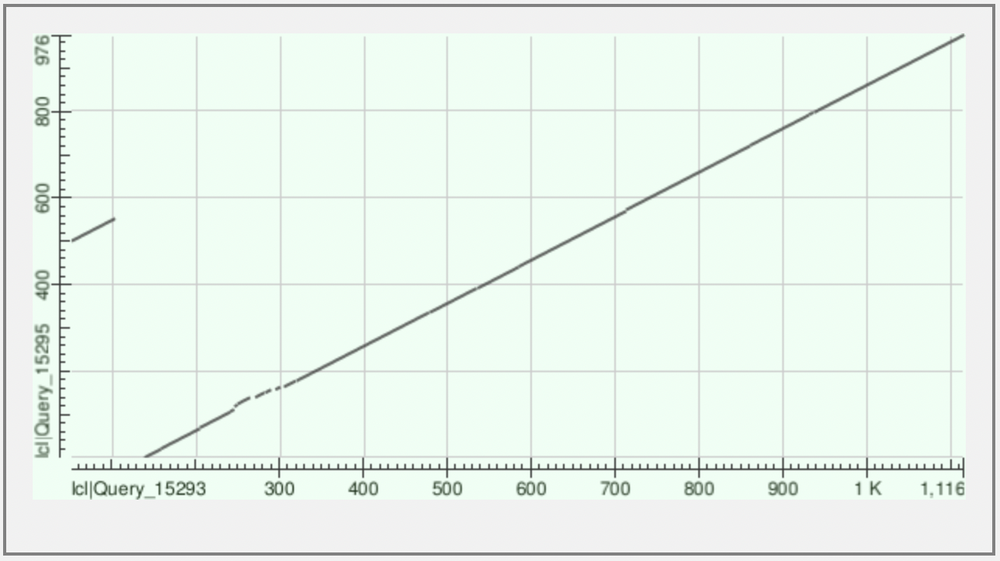
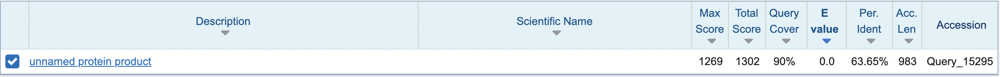

As you can see in the dot plot, there is definitely some overlap, with 63% identity.


## Step 8 - *Compare to nop genes in other organisms*

I blasted the predicted protein sequences for nop1 and nop2 to find orthologs. On lines 2-4, there are proteins that showed up when blasting nop1. On lines 6-8, there are proteins that showed up when blasting nop2.

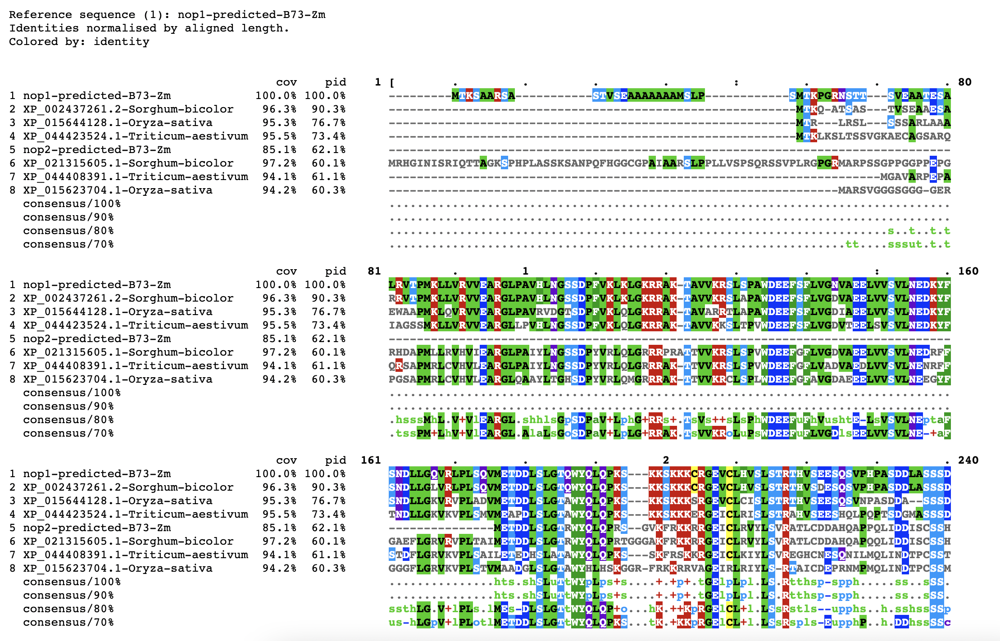
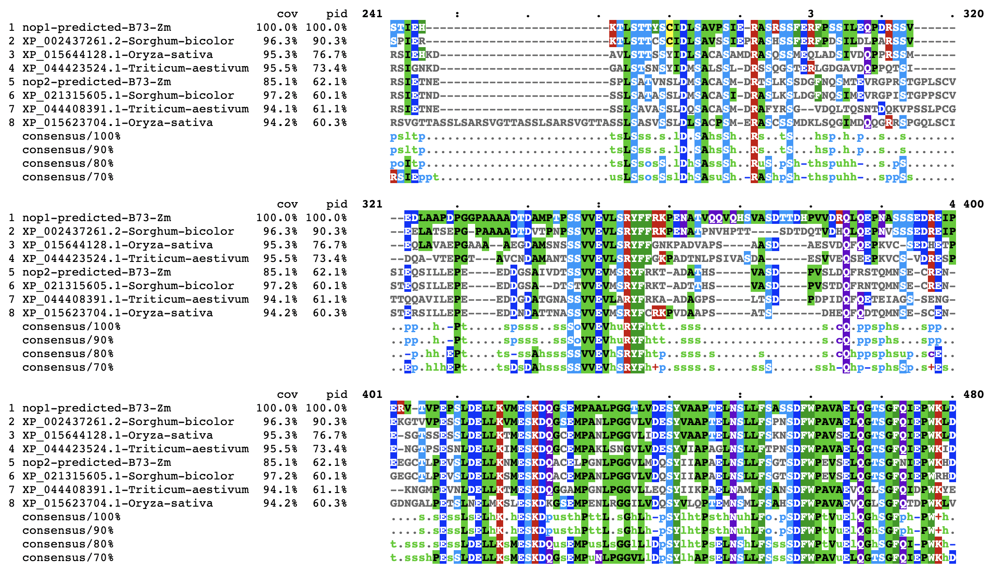
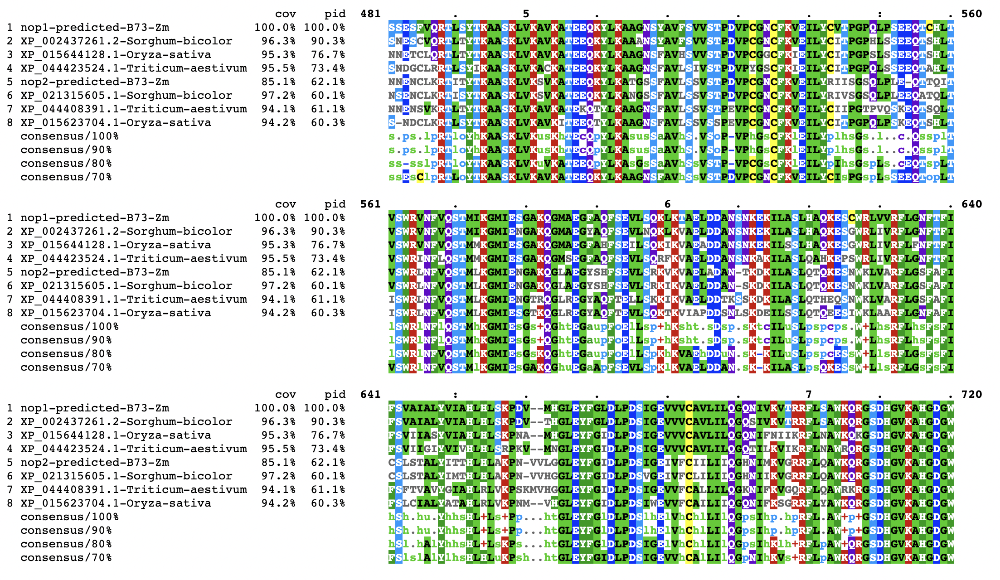
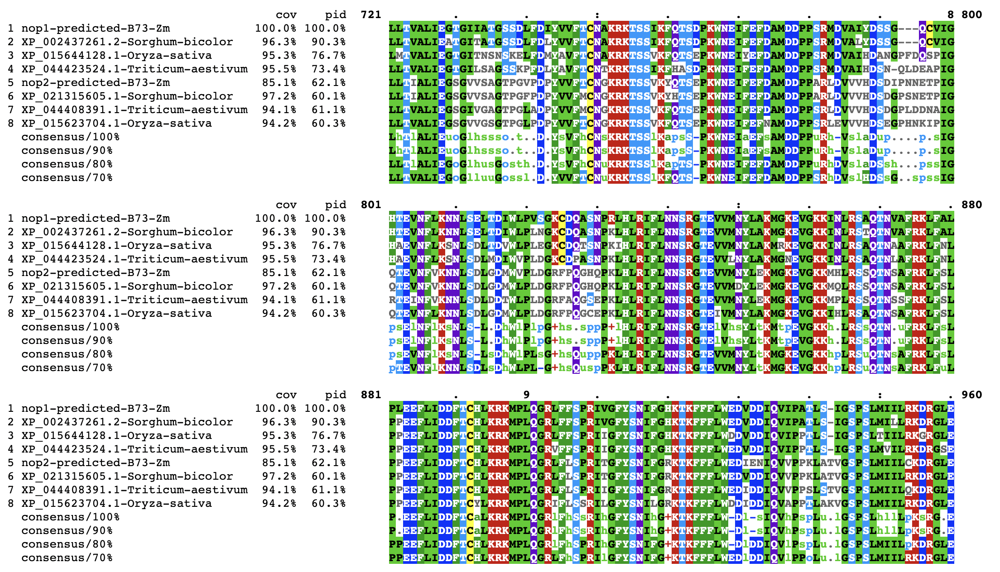
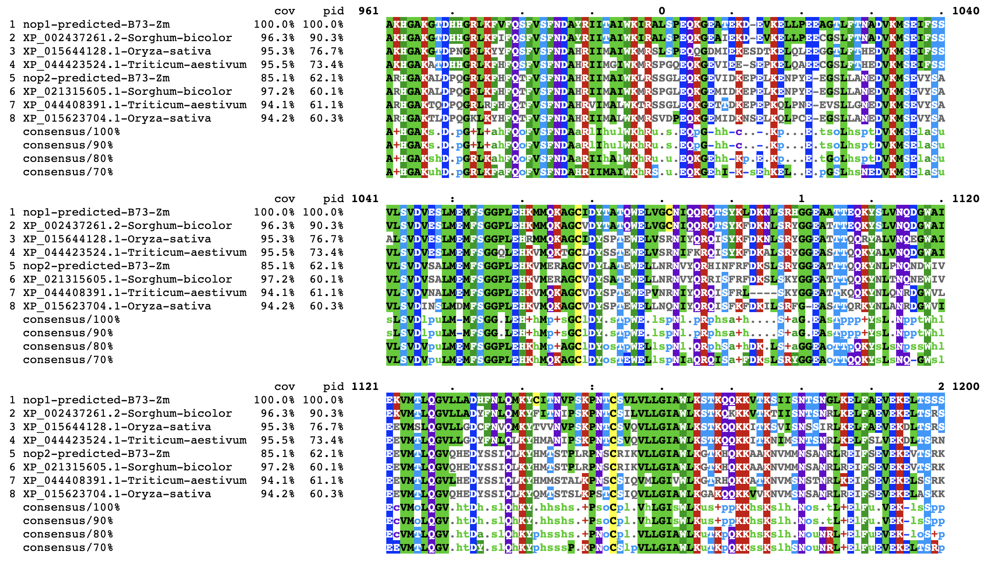
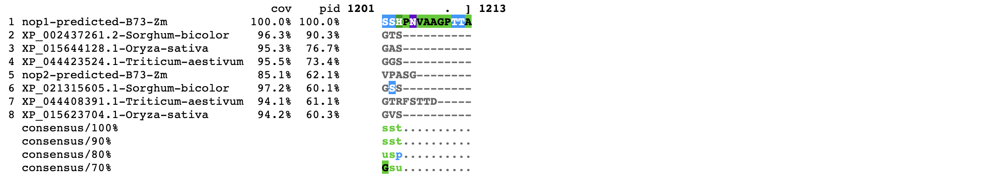

## Step 9 - *Visualizing the Gene Models*

I used IGV genome browser to visualize both nop1 and nop2, and then edited the visualizations in a photo editing app to make them match the style of previously made visualizations.
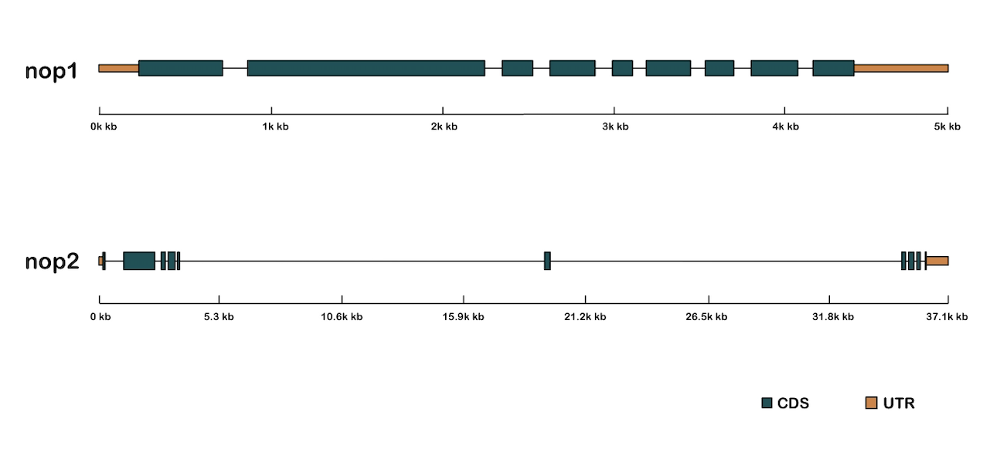